<a href="https://colab.research.google.com/github/PurtiRS/adl1995.github.io/blob/master/Drone_Assig11_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!pip install opencv-python
import cv2 as cv
import matplotlib.pyplot as plt
from PIL import Image, TiffImagePlugin
import matplotlib.patches as mpatches
import numpy as np

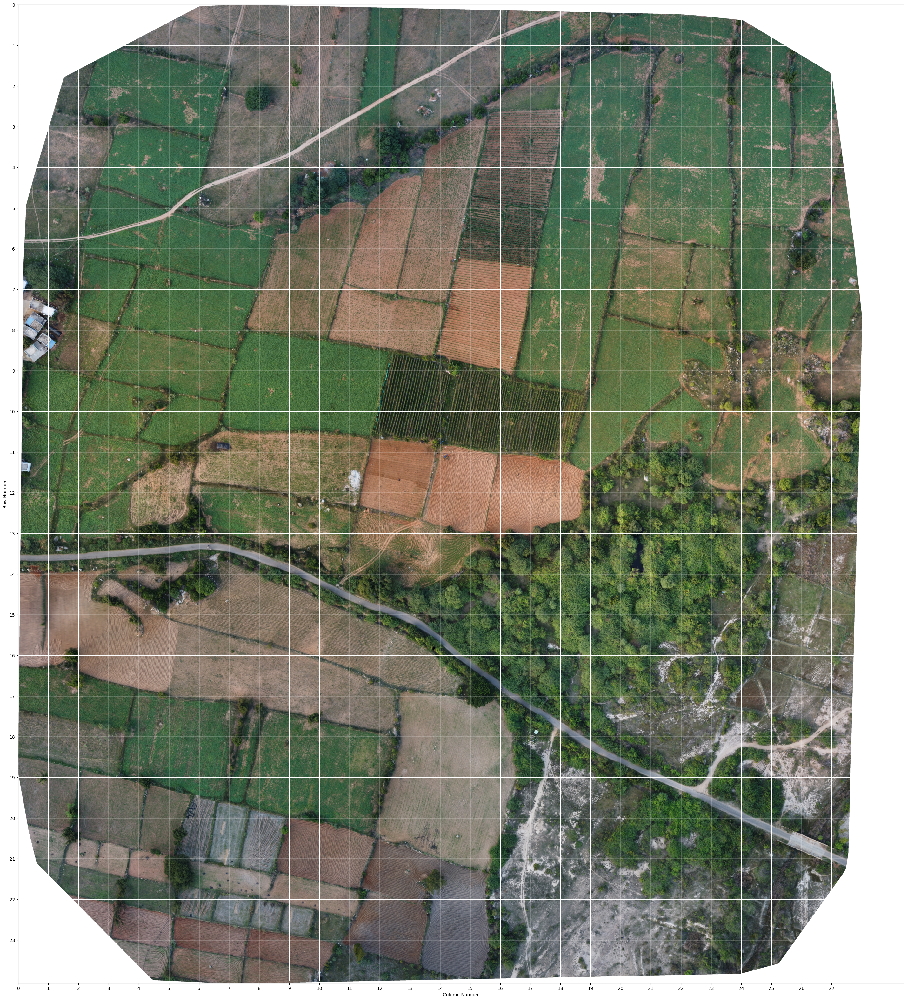

In [4]:
# Verify the file path and ensure the image exists
import os
image_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/Grid_19.tif'
if not os.path.exists(image_path):
    raise FileNotFoundError(f"Image file not found at: {image_path}")

# Use PIL to load the TIFF image and then convert to a NumPy array
try:
    img_pil = Image.open(image_path)
    img = np.array(img_pil)  # Convert to NumPy array
except Exception as e:
    raise IOError(f"Error loading image file: {e}")

# Check if the image loaded successfully
if img is None:
    raise ValueError("Image loading failed. Check the file and its format.")

cell_width = 261
cell_height = 352

plt.figure(figsize=(40, 40))
plt.imshow(img, cmap='gray', vmin=0, vmax=255)

for row in range(24):                                         # change row and column numbers according to the grid
    for col in range(28):
        # Calculate the coordinates of the current cell
        left = col * cell_width
        top = row * cell_height
        right = (col + 1) * cell_width
        bottom = (row + 1) * cell_height

        # Draw the horizontal lines
        plt.plot([left, right], [top, top], color='white', linewidth=1)  # Top line
        # Draw the vertical lines
        plt.plot([left, left], [top, bottom], color='white', linewidth=1)  # Left line

plt.xticks(ticks=np.arange(0, 28 * cell_width, step=cell_width), labels=np.arange(28))
plt.yticks(ticks=np.arange(0, 24 * cell_height, step=cell_height), labels=np.arange(24))

plt.xlabel('Column Number')
plt.ylabel('Row Number')

plt.grid(False)  # Disable the default grid
plt.show()


In [5]:
# cropping the subimages

# Load your image
input_image_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/Grid_19.tif'
img = cv.imread(input_image_path, cv.IMREAD_COLOR)

# Define the number of rows and columns
# change row and column numbers according to the grid
num_rows = 24
num_cols = 28

# Get the dimensions of the original image
image_height, image_width = img.shape[:2]

# Calculate the cell dimensions
#cell_width = image_width // num_cols
#cell_height = image_height // num_rows
cell_width = 261
cell_height = 352

# Output folder for cropped images
output_path_for_grid = "/content/drive/MyDrive/Agri-Drones/Grid_19/sub_grids"

# Create the output directory if it doesn't exist
os.makedirs(output_path_for_grid, exist_ok=True)

# Iterate through each cell
for row in range(num_rows):
    for col in range(num_cols):
        # Calculate the coordinates of the current cell
        left = col * cell_width
        top = row * cell_height
        right = (col + 1) * cell_width
        bottom = (row + 1) * cell_height

        # Crop the image based on the current cell's coordinates
        subimage = img[top:bottom, left:right, :]

        # Save the cropped image as a new image
        output_filename = f"subimage_{row}_{col}.png"
        output_path = os.path.join(output_path_for_grid, output_filename)
        cv.imwrite(output_path, subimage)

print(f"Cropped images saved in {output_path_for_grid}")


Cropped images saved in /content/drive/MyDrive/Agri-Drones/Grid_19/sub_grids


In [6]:
import os
import pandas as pd

# Path to the folder containing the sub-images
sub_image_folder = '/content/drive/MyDrive/Agri-Drones/Grid_19/sub_grids'

# Get a list of all files in the sub-image folder
sub_image_files = [f for f in os.listdir(sub_image_folder) if f.endswith('.png')]

# Create the full paths for each sub-image
sub_image_paths = [os.path.join(sub_image_folder, f) for f in sub_image_files]

# Create a dataframe with a column "sub_image_paths"
df = pd.DataFrame(sub_image_paths, columns=['sub_image_paths'])

# Path to save the CSV file
csv_output_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/sub_image_paths.csv'

# Save the dataframe as a CSV file
df.to_csv(csv_output_path, index=False)

print(f"CSV file saved at: {csv_output_path}")


CSV file saved at: /content/drive/MyDrive/Agri-Drones/Grid_19/sub_image_paths.csv


In [7]:
! pip install tensorflow

import pandas as pd
import numpy as np
import seaborn as sns
import PIL
import warnings
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.utils import to_categorical
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from keras.optimizers import RMSprop
from PIL import Image
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
from keras.applications.inception_v3 import InceptionV3
from keras.applications import ResNet50
from keras import Model, layers
from keras.applications import VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.layers import LeakyReLU
from sklearn.metrics import confusion_matrix

import pandas as pd
from sklearn.model_selection import train_test_split

# Load the CSV file into a pandas DataFrame
data = pd.read_csv('/content/drive/MyDrive/Agri-Drones/Grid_19/training_details.csv')


data

,path,label,crop
0,/content/drive/MyDrive/sub-24-28/ brown /subim...,1,fallow
1,/content/drive/MyDrive/sub-24-28/ brown /subim...,1,fallow
2,/content/drive/MyDrive/sub-24-28/ brown /subim...,1,fallow
3,/content/drive/MyDrive/sub-24-28/ brown /subim...,1,fallow
4,/content/drive/MyDrive/sub-24-28/ brown /subim...,1,fallow
...,...,...,...
128,/content/drive/MyDrive/sub-24-28/green /subima...,0,horsegram
129,/content/drive/MyDrive/sub-24-28/green /subima...,0,horsegram
130,/content/drive/MyDrive/sub-24-28/green /subima...,0,horsegram
131,/content/drive/MyDrive/sub-24-28/green /subima...,0,horsegram


In [8]:
# Define the features (X) and the target variable (y)
X = data.drop(columns=['label'])  # Adjust 'target_column_name' to the name of your target variable
y = data['label']  # Adjust 'target_column_name' to the name of your target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_train

,path,crop
125,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram
109,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram
78,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram
80,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram
97,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram
...,...,...
71,/content/drive/MyDrive/sub-24-28/dark green /s...,tomato
106,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram
14,/content/drive/MyDrive/sub-24-28/ brown /subim...,fallow
92,/content/drive/MyDrive/sub-24-28/green /subima...,horsegram


In [10]:
# Saving the traning dataset in the drive
csv_file_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/training_images_crop_area_est_tomato3_NEW2.csv'
X_train.to_csv(csv_file_path, index=False)

y_train_csv_file_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/training_images_label_crop_area_est_tomato3_NEW2.csv'
y_train.to_csv(y_train_csv_file_path, index=False)

In [11]:
# Run this to use the existing training data in case running the notebook again

X_train = pd.read_csv('/content/drive/MyDrive/Agri-Drones/Grid_19/training_images_crop_area_est_tomato3_NEW2.csv')
y_train = pd.read_csv('/content/drive/MyDrive/Agri-Drones/Grid_19/training_images_label_crop_area_est_tomato3_NEW2.csv')

X_test

test_csv_file_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/testing_images_crop_area_est_tomato3_NEW2.csv'
X_test.to_csv(test_csv_file_path, index=False)

y_test_csv_file_path = '/content/drive/MyDrive/Agri-Drones/Grid_19/testing_images_label_crop_area_est_tomato3_NEW2.csv'
y_test.to_csv(y_test_csv_file_path, index=False)

In [12]:
# Run this to use the existing training data in case running the notebook again

X_test = pd.read_csv('/content/drive/MyDrive/Agri-Drones/Grid_19/testing_images_crop_area_est_tomato3_NEW2.csv')
y_test = pd.read_csv('/content/drive/MyDrive/Agri-Drones/Grid_19/testing_images_label_crop_area_est_tomato3_NEW2.csv')

# Use this to resize the image to what you want
def path_to_RGB(path :str):
   img = Image.open(path)
   img = img.resize((32, 32))
   img_arr = np.array(img)
   img_arr = img_arr.reshape(32,32,3)
   return img_arr

In [13]:
# Changing the size to 75 X 75 because of InceptionV3

def path_to_RGB_75(path :str):
   img = Image.open(path)
   img = img.resize((75, 75))
   img_arr = np.array(img)
   img_arr = img_arr.reshape(75,75,3)
   return img_arr

In [15]:
X_train['path']=X_train['path'].apply(path_to_RGB)
X_test['path']=X_test['path'].apply(path_to_RGB)
X_train['path']=X_train['path']/255
X_test['path']=X_test['path']/255

In [16]:
no_of_training= X_train['path'].shape[0]
no_of_training

no_of_testing= X_test['path'].shape[0]
no_of_testing

X=[]
for x in X_train['path']:
    for j in x:
        for i in j:
            for a in i :
                X.append(a)

X=np.asarray(X).reshape(no_of_training,32,32,3)
Y=y_train
Y=to_categorical(Y,num_classes=3)

# X=np.asarray(X).reshape(no_of_training,75,75,3)
# Y=y_train
# Y=to_categorical(Y,num_classes=3)

#X_test

#similar as done for the test data
X_t=[]
for x in X_test['path']:
    for j in x:
        for i in j:
            for a in i :
                X_t.append(a)

X_t=np.asarray(X_t).reshape(no_of_testing,32,32,3)

# X_t=np.asarray(X_t).reshape(no_of_test,75,75,3)

#X_t

Y_test=to_categorical(y_test,num_classes=3)
#print(Y_test)

In [17]:
from keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Dropout, concatenate, BatchNormalization, Activation
from keras.models import Model

# Define input layer
input_layer = Input(shape=(32, 32, 3))

# Function for composite operation (BN + Conv)
def composite_function(input_features, filters, kernel_size):
    # Batch normalization
    x = BatchNormalization()(input_features)
    # ReLU activation
    x = Activation('relu')(x)
    # Convolution
    x = Conv2D(filters=filters, kernel_size=kernel_size, padding='Same', activation='relu')(x)
    return x
# Kernel size changed from (5,5) to (3,3)
# First convolutional layer
conv1_1 = composite_function(input_layer, filters=32, kernel_size=(3, 3))
conv1_2 = composite_function(conv1_1, filters=32, kernel_size=(3, 3))

# Second convolutional layer
conv2_1 = composite_function(input_layer, filters=32, kernel_size=(3, 3))
conv2_2 = composite_function(conv2_1, filters=32, kernel_size=(3, 3))

# Max-pooling layer
pool1 = MaxPooling2D(pool_size=(2, 2))(conv1_2)
pool2 = MaxPooling2D(pool_size=(2, 2))(conv2_2)

# Dropout layer
dropout1 = Dropout(0.25)(pool1)
dropout2 = Dropout(0.25)(pool2)

# Third convolutional layer
conv3 = composite_function(dropout1, filters=64, kernel_size=(3, 3))

# Fourth convolutional layer
conv4 = composite_function(dropout2, filters=64, kernel_size=(3, 3))

# Max-pooling layer
pool3 = MaxPooling2D(pool_size=(2, 2), strides=(2, 2))(conv3)
pool4 = MaxPooling2D(pool_size=(2, 2), strides=(2, 2))(conv4)

Epoch 1/4
4/4 ━━━━━━━━━━━━━━━━━━━━ 6s 321ms/step - accuracy: 0.4074 - loss: 2.3127 - val_accuracy: 0.5926 - val_loss: 0.9925
Epoch 2/4
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 193ms/step - accuracy: 0.7057 - loss: 0.7757 - val_accuracy: 0.8889 - val_loss: 1.0435
Epoch 3/4
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 195ms/step - accuracy: 0.7248 - loss: 0.8222 - val_accuracy: 0.7407 - val_loss: 1.0639
Epoch 4/4
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 191ms/step - accuracy: 0.8560 - loss: 0.4131 - val_accuracy: 0.6667 - val_loss: 1.0835


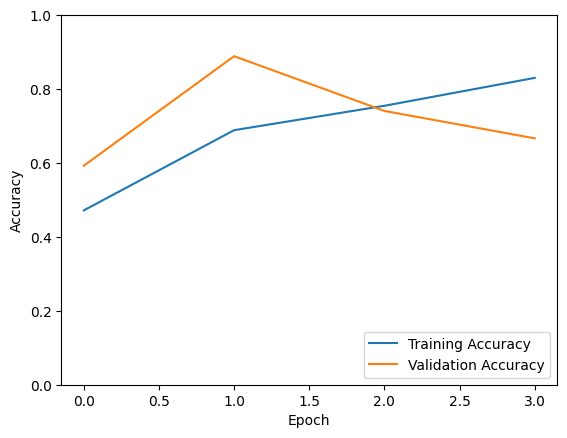

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


In [18]:
# Dropout layer
dropout3 = Dropout(0.25)(pool3)
dropout4 = Dropout(0.25)(pool4)

# Concatenate feature maps from preceding layers
concatenated_features = concatenate([dropout3, dropout4])

# Transition block
conv_transition = composite_function(concatenated_features, filters=32, kernel_size=(1, 1))
pool_transition = MaxPooling2D(pool_size=(2, 2))(conv_transition)

# Flatten layer
# [1,[2,3]] = [1,2,3]
flatten = Flatten()(pool_transition)

# First fully connected layer
fc1 = Dense(256, activation='relu')(flatten)

# Dropout layer
dropout5 = Dropout(0.5)(fc1)

# Second fully connected layer
output_layer = Dense(3, activation='softmax')(dropout5)

# Create the model
model_relu = Model(inputs=input_layer, outputs=output_layer)

optimizer = RMSprop(learning_rate=0.001, rho=0.9, epsilon=1e-08)
model_relu.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"])

history = model_relu.fit(X, Y, epochs=4, validation_data=(X_t, Y_test))

# Plot the accuracy vs. epoch graph
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label = 'Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')
plt.show()

array_pred = model_relu.predict(X_t)
y_pred = []

Confusion Matrix:
[[8 0 0]
 [6 9 1]
 [2 0 1]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 929ms/step


array([[0.33989707, 0.32418266, 0.33592024]], dtype=float32)

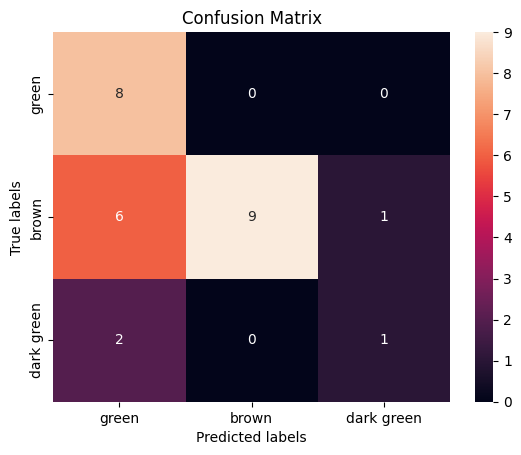

In [19]:
for inner_arr in array_pred:
        max_index = np.argmax(inner_arr)
        new_inner_arr = np.zeros_like(inner_arr)
        new_inner_arr[max_index] = 1
        y_pred.append(new_inner_arr)
y_pred = np.array(y_pred)

y_pred

Y_test

cm = confusion_matrix(Y_test.argmax(axis=1), y_pred.argmax(axis=1))

print("Confusion Matrix:")
print(cm)

import seaborn as sns

subimg_lables = ['green','brown','dark green']

ax= plt.subplot()

cm = confusion_matrix(np.asarray(Y_test).argmax(axis=1), np.asarray(y_pred).argmax(axis=1))
sns.heatmap(cm, annot=True, fmt='g', ax=ax);  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.set_title('Confusion Matrix');
ax.xaxis.set_ticklabels(subimg_lables); ax.yaxis.set_ticklabels(subimg_lables);

sample_path = "/content/drive/MyDrive/sub-24-28/green /subimage_0_21.png"
sample_path = path_to_RGB(sample_path)
sample_path = sample_path/255
X_sample=[]

for j in sample_path:
    for i in j:
        for a in i :
            X_sample.append(a)

X_sample=np.asarray(X_sample).reshape(1,32,32,3)

model_relu.predict(X_sample)